In [52]:
import numpy as np
import pandas as pd

import plotly.express as px
import plotly.io as pio

from sklearn.neighbors import NearestNeighbors
from matplotlib import pyplot as plt

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score

from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

In [53]:
df = pd.read_csv("uber-trip-data/uber-raw-data-apr14.csv")
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [54]:
df['Year'] = pd.to_datetime(df['Date/Time']).dt.year
df['Month'] = pd.to_datetime(df['Date/Time']).dt.month
df['Day'] = pd.to_datetime(df['Date/Time']).dt.day
df['Date'] = pd.to_datetime(df['Date/Time']).dt.date
df['Hour'] = pd.to_datetime(df['Date/Time']).dt.hour
df['Minute'] = pd.to_datetime(df['Date/Time']).dt.minute
df['Second'] = pd.to_datetime(df['Date/Time']).dt.second
df['Day_name'] = pd.to_datetime(df['Date/Time']).dt.day_name()

df.drop(["Date/Time"], axis = 1, inplace=True)

df.head(5)

,Lat,Lon,Base,Year,Month,Day,Date,Hour,Minute,Second,Day_name
0,40.7690,-73.9549,B02512,2014,4,1,2014-04-01,0,11,0,Tuesday
1,40.7267,-74.0345,B02512,2014,4,1,2014-04-01,0,17,0,Tuesday
2,40.7316,-73.9873,B02512,2014,4,1,2014-04-01,0,21,0,Tuesday
3,40.7588,-73.9776,B02512,2014,4,1,2014-04-01,0,28,0,Tuesday
4,40.7594,-73.9722,B02512,2014,4,1,2014-04-01,0,33,0,Tuesday


Base : TLC (Taxi and Limousine Commission) code
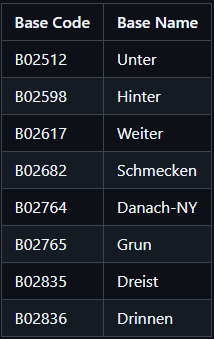

In [32]:
df.shape

(564516, 11)

In [33]:
df.head()

,Lat,Lon,Base,Year,Month,Day,Date,Hour,Minute,Second,Day_name
0,40.7690,-73.9549,B02512,2014,4,1,2014-04-01,0,11,0,Tuesday
1,40.7267,-74.0345,B02512,2014,4,1,2014-04-01,0,17,0,Tuesday
2,40.7316,-73.9873,B02512,2014,4,1,2014-04-01,0,21,0,Tuesday
3,40.7588,-73.9776,B02512,2014,4,1,2014-04-01,0,28,0,Tuesday
4,40.7594,-73.9722,B02512,2014,4,1,2014-04-01,0,33,0,Tuesday


In [34]:
fig = px.scatter_map(df, lat="Lat", lon="Lon", color="Base", zoom=8, animation_frame = 'Day_name')
fig.show()

In [35]:
df_hour = df.sort_values('Hour', ascending=True)
fig = px.scatter_map(df_hour, lat="Lat", lon="Lon", color="Base", zoom=8, animation_frame = 'Hour')
fig.show()

In [36]:
df.groupby('Day_name')['Day_name'].count().reset_index(name='count').sort_values(['count'], ascending=False)

,Day_name,count
6,Wednesday,108631
5,Tuesday,91185
0,Friday,90303
4,Thursday,85067
2,Saturday,77218
1,Monday,60861
3,Sunday,51251


In [37]:
df.groupby('Hour')['Hour'].count().reset_index(name='count').sort_values(['count'], ascending=False)

,Hour,count
17,17,45475
18,18,43003
16,16,42003
19,19,38923
21,21,36964
20,20,36244
15,15,35324
22,22,30645
14,14,27190
7,7,24924


# Preprocessing


In [55]:
mask = (df["Day_name"] == "Wednesday") & (df["Hour"] == 17)
df_copy = df[mask]

df_copy = df_copy[["Lat", "Lon"]]

df_copy.reset_index(drop=True, inplace=True)

df_copy.head(5)

,Lat,Lon
0,40.7625,-73.9810
1,40.7574,-73.9862
2,40.7605,-73.9821
3,40.7518,-73.9758
4,40.7174,-74.0027


In [39]:
df_copy.shape

(9151, 2)

In [56]:
numeric_features = ["Lat", "Lon"]
#categorical_features = ["Day_name"]

numeric_transformer = Pipeline(steps=[
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(
    steps=[
    ('encoder', OneHotEncoder(drop='first'))
    ])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
       # ('cat', categorical_transformer, categorical_features)
    ])

In [57]:
print("Preprocessing...")
X = preprocessor.fit_transform(df_copy)
print('...Terminé.')
print(X[0:5, :])
print()

Preprocessing...
...Terminé.
[[ 0.60069517 -0.00595534]
 [ 0.43467674 -0.13042207]
 [ 0.5355899  -0.03228484]
 [ 0.25238198  0.1185114 ]
 [-0.86742863 -0.5253646 ]]



In [42]:
X.shape

(9151, 2)

# Calcul des clusters avec KMEANS

In [43]:
%%time
wcss =  []

for i in range (2, 12):
    kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
    kmeans.fit(X)
    wcss.append([i, kmeans.inertia_, silhouette_score(X, kmeans.labels_)])
    print("Clusters : ", i)
    print("-----------------")

wcss = pd.DataFrame(wcss, columns=["n_clusters", "inertias", "silhouette"])
wcss

Clusters :  2
-----------------
Clusters :  3
-----------------
Clusters :  4
-----------------
Clusters :  5
-----------------
Clusters :  6
-----------------
Clusters :  7
-----------------
Clusters :  8
-----------------
Clusters :  9
-----------------
Clusters :  10
-----------------
Clusters :  11
-----------------
CPU times: total: 18.3 s
Wall time: 14.3 s


,n_clusters,inertias,silhouette
0,2,16127.559964,0.890704
1,3,11685.086780,0.467939
2,4,6907.327733,0.477921
3,5,5571.326388,0.476384
4,6,4795.436847,0.382985
5,7,3561.225692,0.398259
6,8,2954.647420,0.472116
7,9,2542.805496,0.429572
8,10,2226.822962,0.438533
9,11,2170.869621,0.438251


In [44]:
px.line(wcss, x = "n_clusters", y = "inertias", title="kmeans inertias per cluster")

In [45]:
px.bar(wcss, x = "n_clusters", y = "silhouette", title="kmeans silhouette per cluster")

Je pars sur 4 clusters

In [58]:
km = KMeans(n_clusters = 4)
km.fit(X)

df_copy["Cluster_KMeans"] = pd.Series(km.labels_)
df_copy.head()

,Lat,Lon,Cluster_KMeans
0,40.7625,-73.9810,0
1,40.7574,-73.9862,0
2,40.7605,-73.9821,0
3,40.7518,-73.9758,0
4,40.7174,-74.0027,1


In [95]:
fig = px.scatter_map(df_copy, lat="Lat", lon="Lon", color="Cluster_KMeans", zoom=8)
fig.show()

# Calcul des clusters avec DBSCAN

If your data has more than 2 dimensions, choose MinPts = 2*dim, where dim= the dimensions of your data set (Sander et al., 1998)
#https://stats.stackexchange.com/questions/88872/a-routine-to-choose-eps-and-minpts-for-dbscan

In [91]:
k = 4

nn = NearestNeighbors(n_neighbors=k)
neighbors = nn.fit(X)

distances, _ = neighbors.kneighbors(X)
distances = np.sort(distances[:, k-1])

px.line(distances)

In [92]:
db = DBSCAN(eps=0.76, min_samples=6, metric="manhattan")

db.fit(X)

df_copy["Cluster_DBSCAN"] = pd.Series(db.labels_)
df_copy.head()

,Lat,Lon,Cluster_KMeans,Cluster_DBSCAN
0,40.7625,-73.9810,0,0
1,40.7574,-73.9862,0,0
2,40.7605,-73.9821,0,0
3,40.7518,-73.9758,0,0
4,40.7174,-74.0027,1,0


In [93]:
np.unique(db.labels_)

array([-1,  0,  1,  2,  3,  4])

In [94]:
fig = px.scatter_map(df_copy[df_copy.Cluster_DBSCAN != -1], lat="Lat", lon="Lon", color="Cluster_DBSCAN", zoom=8)
fig.show()